In [ ]:
# !pip install numpy pandas matplotlib seaborn

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
from nmr.multiple_simulations import metrics_multiple_simulations

In [ ]:
FIG_PATH = "Figures"

In [4]:
DATA_PATH = "2D/15N_HSQC_GB1_reduced"

In [8]:
h_lim = (0.015, 0.035)
n_lim = (-0.01, 0.015)
h_t_lim = (0, 0.01)
n_t_lim = (0, 0.005)
i_s_lim = (0.8, 0.9)

max_distance = 0.05
trash_cost = 0.09

n = 1000

metrics_seeds = metrics_multiple_simulations(n, 
                                             DATA_PATH=DATA_PATH, 
                                             k=54,
                                             scale_nucl={"N": 10},
                                             nuclei=['15N', '1H'], 
                                             max_peak_fraction=0.01, 
                                             h_lim = h_lim,
                                             n_lim = n_lim,
                                             h_t_lim = h_t_lim,
                                             n_t_lim = n_t_lim,
                                             max_distance=max_distance, 
                                             trash_cost=trash_cost, 
                                             extended = True,
                                             warn=True,
                                             default_rng = False,
                                            )

100%|█████████████████████████████████████████████████████████████████████| 1000/1000 [28:26<00:00,  1.71s/it]


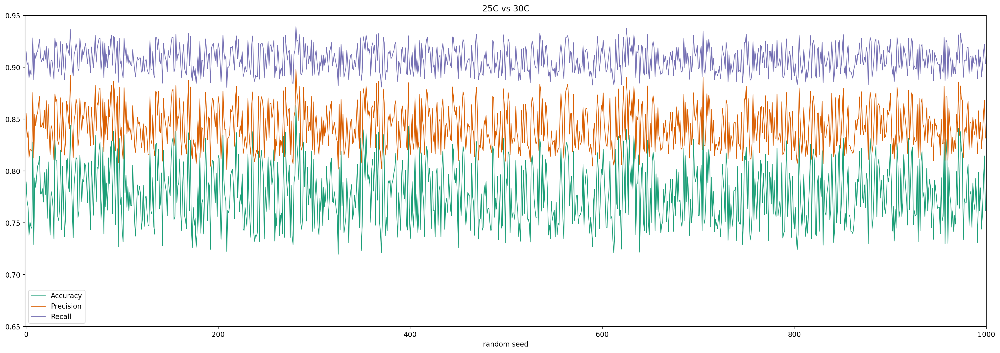

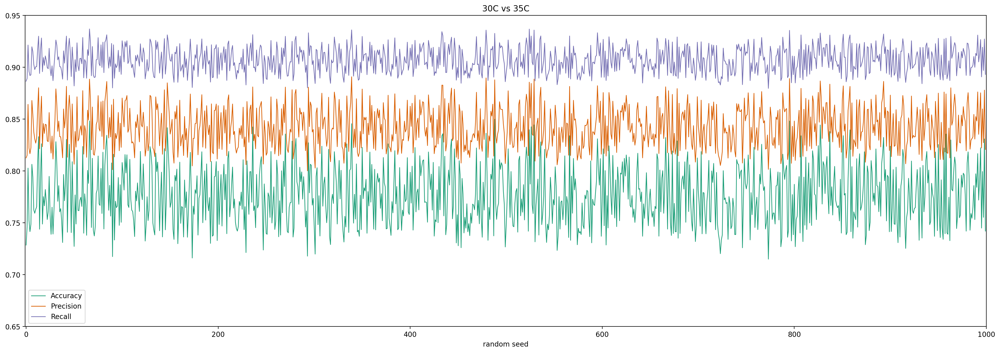

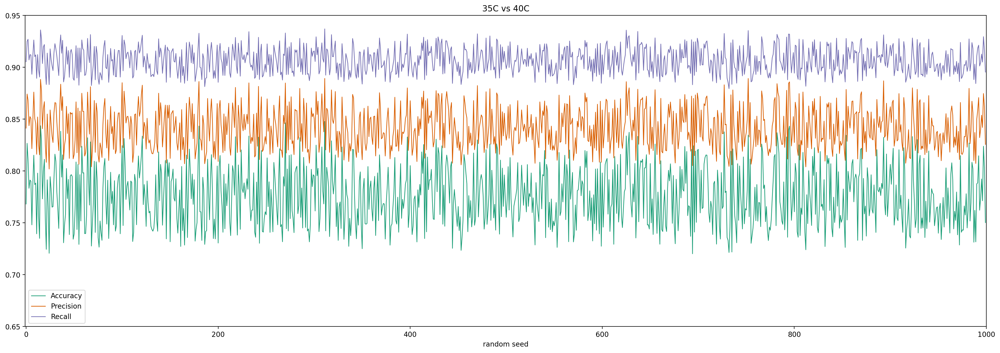

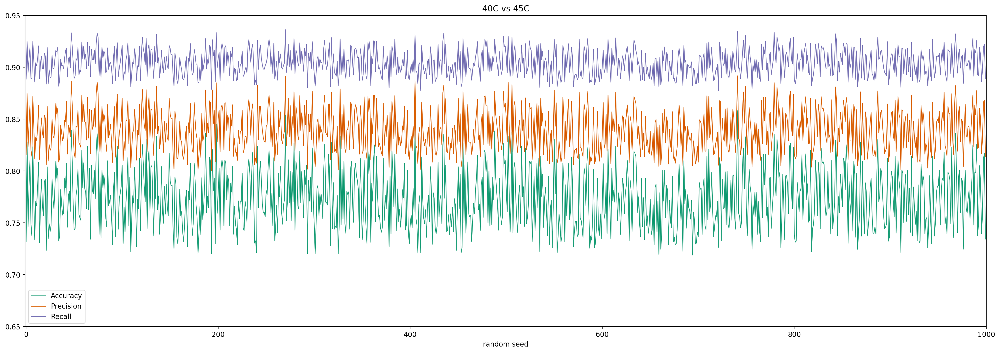

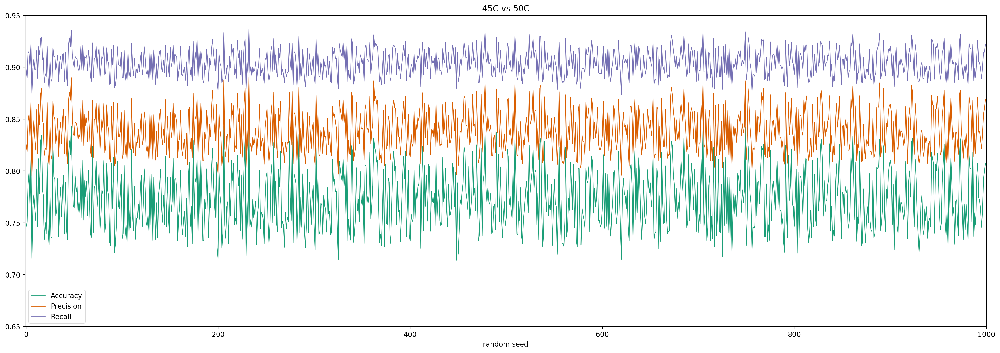

In [21]:
n = 1000
cmap = plt.get_cmap('Dark2')

plt.rcParams['axes.prop_cycle'] = plt.cycler("color", cmap.colors)

for align in metrics_seeds:
    fig, ax = plt.subplots(1, 1, figsize=(20, 7), constrained_layout=True, dpi=200)
    for metric in metrics_seeds[align]:
        if metric in ['Accuracy', 'Precision (macro)', 'Recall (macro)']:
            ax.plot(np.arange(n), metrics_seeds[align][metric], label = metric.split()[0], alpha=1, lw = 1, linestyle='-') #, c = metric_to_color[metric])
    ax.set(xlabel="random seed", title= f"{align}")
    ax.set_ylim(0.65, 0.95)
    ax.set_xlim(-1, n)
    ax.legend()
    plt.savefig(f"{FIG_PATH}/{align}_different_seeds.png")
    plt.show()

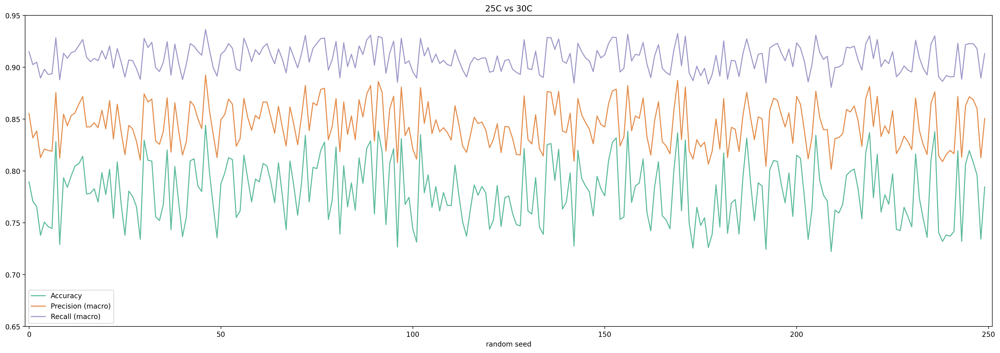

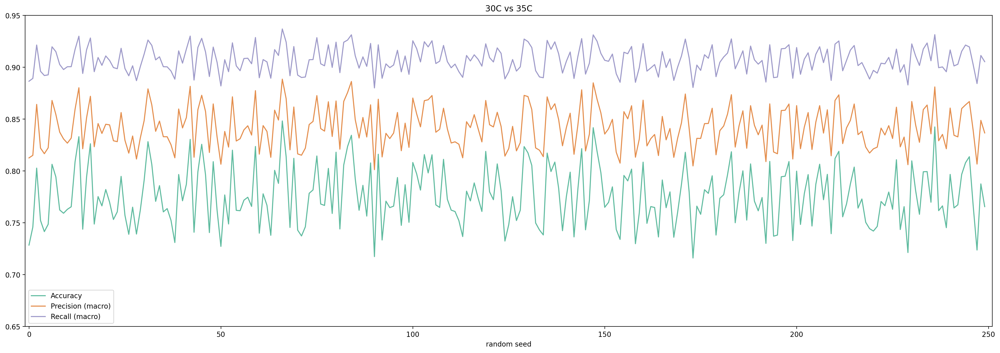

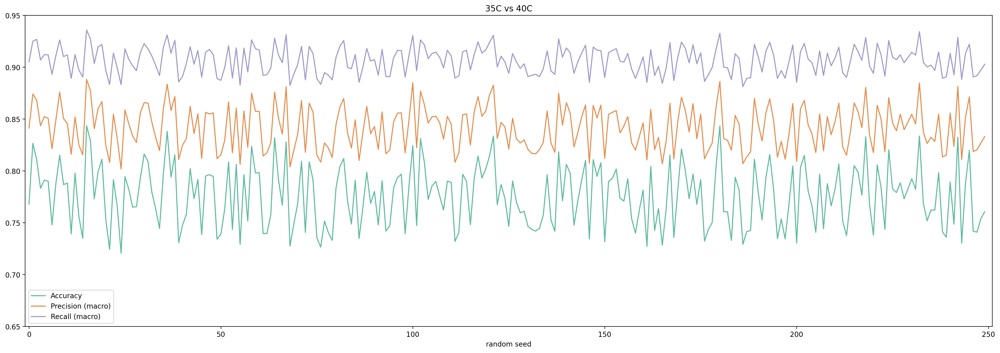

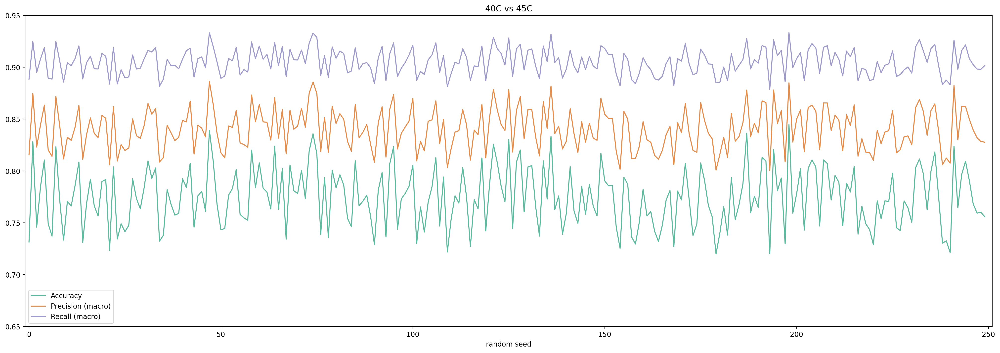

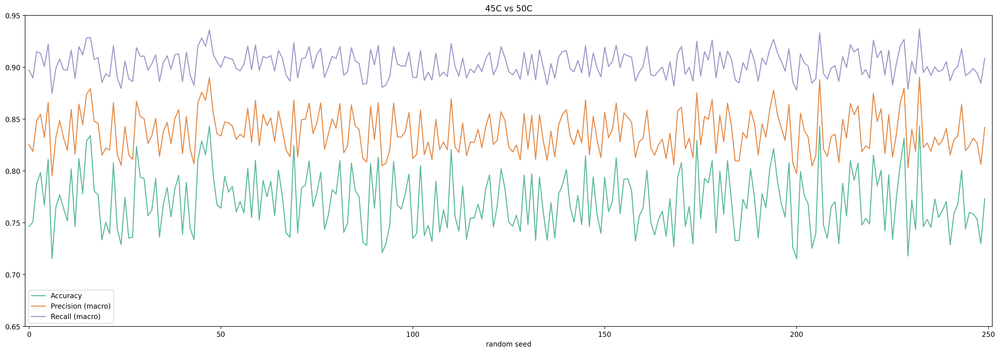

...

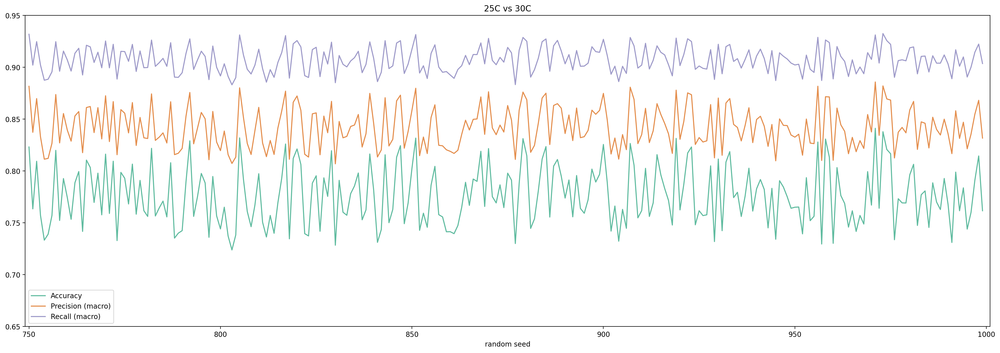

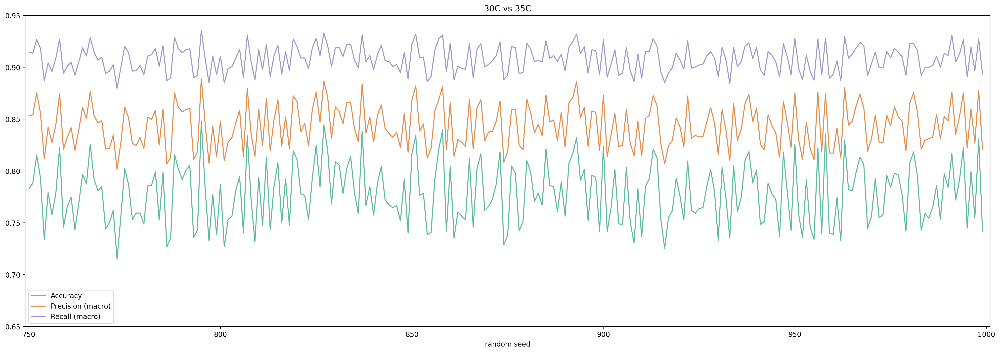

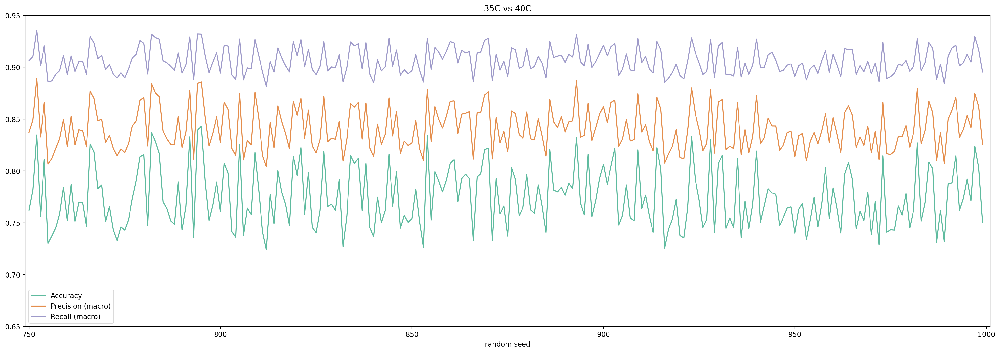

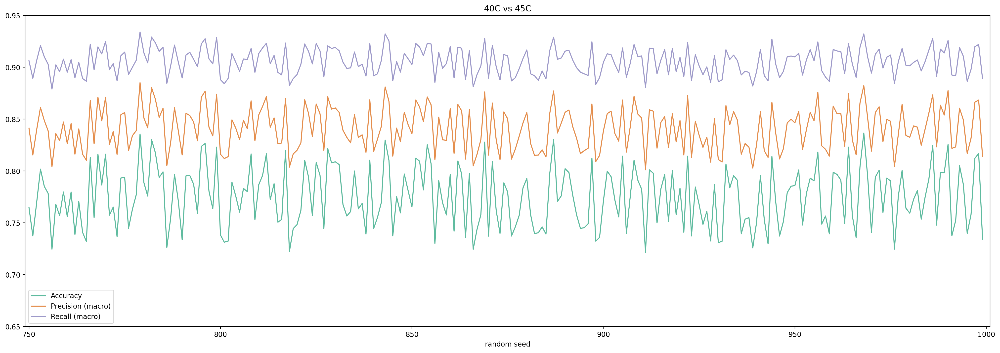

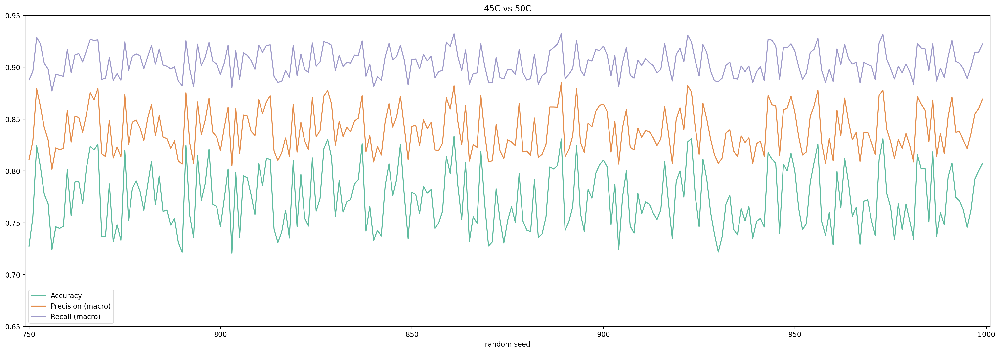

In [18]:
cmap = plt.get_cmap('Dark2')
plt.rcParams['axes.prop_cycle'] = plt.cycler("color", cmap.colors)


for m in [(0, 250), (250, 500), (500, 750), (750, 1000)]:
    for align in metrics_seeds:
        fig, ax = plt.subplots(1, 1, figsize=(20, 7), constrained_layout=True, dpi=200)
        for metric in metrics_seeds[align]:
            if metric in ['Accuracy', 'Precision (macro)', 'Recall (macro)']:
                ax.plot(np.arange(m[0], m[1]), metrics_seeds[align][metric][m[0]:m[1]], label = metric, alpha=0.7, linestyle='-')
        ax.set(xlabel="random seed", title= f"{align}")
        ax.set_ylim(0.65, 0.95)
        ax.set_xlim(m[0]-1, m[1]+1)
        ax.legend()
        plt.savefig(f"{FIG_PATH}/different_random_seed_extended_metrics/{align}_{m}_different_seeds.png")
        plt.show()

In [11]:
df_means = pd.DataFrame(columns = ['alignment', 'Accuracy', 'Precision', 'Recall'])

temps = [(25, 30), (30, 35), (35, 40), (40, 45), (45, 50)]
for t in temps:
    col = f"{t[0]}C vs {t[1]}C"
    print(col)
    for m in metrics_seeds[col]:
        if m in ['Accuracy', 'Precision (macro)', 'Recall (macro)']:
            print(m)
            print("mean =", np.mean(metrics_seeds[col][m]))
            print("sts = ", np.std(metrics_seeds[col][m]))
            print("****************************")
            print()

25C vs 30C
Accuracy
mean = 0.7774084494620649
sts =  0.029140750748854177
****************************

Precision (macro)
mean = 0.8431253979049032
sts =  0.020574822491283788
****************************

Recall (macro)
mean = 0.9077480978431345
sts =  0.012649365412192054
****************************

30C vs 35C
Accuracy
mean = 0.7761480501399951
sts =  0.028397732169035846
****************************

Precision (macro)
mean = 0.8423049389396355
sts =  0.019951906241538888
****************************

Recall (macro)
mean = 0.9071873047083001
sts =  0.012509532216759045
****************************

35C vs 40C
Accuracy
mean = 0.7754316565804865
sts =  0.028482633371709563
****************************

Precision (macro)
mean = 0.8417658546752116
sts =  0.020057467113341852
****************************

Recall (macro)
mean = 0.9066006593863546
sts =  0.01256719340322327
****************************

40C vs 45C
Accuracy
mean = 0.7729450599607169
sts =  0.02870293343247152
*************

In [19]:
df_means = pd.DataFrame(
                        columns = ['Accuracy', 'Precision', 'Recall'], 
                        index=['25C vs 30C', '30C vs 35C', '35C vs 40C', '40C vs 45C', '45C vs 50C'],
                       )

df_stds = pd.DataFrame(
                        columns = ['Accuracy', 'Precision', 'Recall'], 
                        index=['25C vs 30C', '30C vs 35C', '35C vs 40C', '40C vs 45C', '45C vs 50C'],
                       )

for col in metrics_seeds:
    # means
    df_means.loc[col, 'Accuracy'] = np.mean(metrics_seeds[col]['Accuracy'])
    df_means.loc[col, 'Precision'] = np.mean(metrics_seeds[col]['Precision (macro)'])
    df_means.loc[col, 'Recall'] = np.mean(metrics_seeds[col]['Recall (macro)'])
    # stds
    df_stds.loc[col, 'Accuracy'] = np.std(metrics_seeds[col]['Accuracy'])
    df_stds.loc[col, 'Precision'] = np.std(metrics_seeds[col]['Precision (macro)'])
    df_stds.loc[col, 'Recall'] = np.std(metrics_seeds[col]['Recall (macro)'])
    

df_both = pd.DataFrame(
    columns = ['Accuracy', 'Precision', 'Recall'], 
    index=['25C vs 30C', '30C vs 35C', '35C vs 40C', '40C vs 45C', '45C vs 50C']
)
for ind in df_both.index:
    for c in df_both.columns:
        df_both.loc[ind, c] = f"{df_means.loc[ind, c].round(3)} $\\pm$ {df_stds.loc[ind, c].round(3)}"
df_both

,Accuracy,Precision,Recall
25C vs 30C,0.777 $\pm$ 0.029,0.843 $\pm$ 0.021,0.908 $\pm$ 0.013
30C vs 35C,0.776 $\pm$ 0.028,0.842 $\pm$ 0.02,0.907 $\pm$ 0.013
35C vs 40C,0.775 $\pm$ 0.028,0.842 $\pm$ 0.02,0.907 $\pm$ 0.013
40C vs 45C,0.773 $\pm$ 0.029,0.84 $\pm$ 0.02,0.905 $\pm$ 0.013
45C vs 50C,0.772 $\pm$ 0.029,0.839 $\pm$ 0.02,0.904 $\pm$ 0.013


In [20]:
print(df_both.to_latex(index=True))

\begin{tabular}{llll}
\toprule
 & Accuracy & Precision & Recall \\
\midrule
25C vs 30C & 0.777 $\pm$ 0.029 & 0.843 $\pm$ 0.021 & 0.908 $\pm$ 0.013 \\
30C vs 35C & 0.776 $\pm$ 0.028 & 0.842 $\pm$ 0.02 & 0.907 $\pm$ 0.013 \\
35C vs 40C & 0.775 $\pm$ 0.028 & 0.842 $\pm$ 0.02 & 0.907 $\pm$ 0.013 \\
40C vs 45C & 0.773 $\pm$ 0.029 & 0.84 $\pm$ 0.02 & 0.905 $\pm$ 0.013 \\
45C vs 50C & 0.772 $\pm$ 0.029 & 0.839 $\pm$ 0.02 & 0.904 $\pm$ 0.013 \\
\bottomrule
\end{tabular}



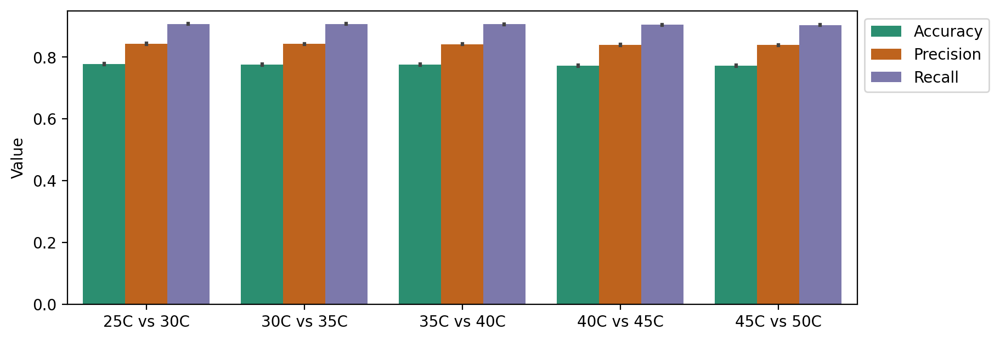

In [14]:
df_all = pd.DataFrame(columns = ['Alignment', 'Accuracy', 'Precision', 'Recall'])

temps = [(25, 30), (30, 35), (35, 40), (40, 45), (45, 50)]
for t in temps:
    df_means = pd.DataFrame(columns = ['Alignment', 'Accuracy', 'Precision', 'Recall'])
    col = f"{t[0]}C vs {t[1]}C"
    df_means['Accuracy'] = metrics_seeds[col]['Accuracy']
    df_means['Precision'] = metrics_seeds[col]['Precision (macro)']
    df_means['Recall'] = metrics_seeds[col]['Recall (macro)']
    df_means['Alignment'] = [col for _ in metrics_seeds[col]['Accuracy']]
    if df_all.shape[0] == 0:
        df_all = df_means
    else:
        df_all = pd.concat([df_all, df_means])

df_melted = df_all.melt(id_vars='Alignment', var_name='Metric', value_name='Value')
    
cmap = plt.get_cmap('Dark2')
plt.rcParams['axes.prop_cycle'] = plt.cycler("color", cmap.colors)

fig, ax = plt.subplots(1, 1, figsize=(9, 3), constrained_layout=True, dpi=200)
sns.barplot(data=df_melted,
            x='Alignment',
            y='Value',
            hue='Metric',
            ax=ax,
           )
# ax.set(xlabel="random seed", title= f"{align}")
plt.ylim(0.0, 0.95)
plt.xlabel("")
# ax.set_xlim()
plt.legend(bbox_to_anchor=(1, 1))
plt.savefig(f"{FIG_PATH}/Average_metrics_different_seeds.png")
plt.show()